Sagari Datta

MUSA620/Data Wrangling

Spring 2019

PROJECT DESCRIPTION:

The goal of this project is to find out how Airbnb is faring in New York City. Datasets from different sources were downloaded for this purpose to determine which neighborhoods in the city had the greatest concentration of Airbnb listings and to find out the demographic and real-estate characteristics of these neighborhoods. Furthermore, a sentiment analysis was performed to determine how Airbnb is perceived in NYC. 

DATSETS USED:

Structured Data

1.	Kaggle.com – csv files for Airbnb listings in NYC
2.	Open Data NYC – API query (SodaPy)

Unstructured Data

1.	Twitter – Scrapping twitter data 

Note: Census Data not used but code provided.

METHODOLOGY:

Structured Data

1.	Download data from different sources 
2.	Convert relevant data frames into geopandas data frames
3.	Spatial join and aggregate data as needed. Neighborhood population, Airbnb listings and property values were aggregated to each neighborhood and the different joins (beside spatial joins) were based on neighborhood name. The demographic and housing information were used as proxy variables for census variables relating to race, income, rent, median income, etc. The demographic and evictions data had no geographic information other than zipcode. The housing information had latitude and longitude values, but these were in an incorrect format. Therefore, the aggregation and joins had to be all made based on zipcode i.e., not spatial join but a pd.merge based on the zipcode column. These were then further aggregated at the community/council district level since the housing data had community district information. Furthermore, since the community district numbering formats were not consistent for the different datasets, these were rectified as well for the purpose of performing the joins.
4.	Exploratory data analysis and visualizations – maps, plots, charts, etc.
5.	Dashboard – Dashboard created using Dash. Folium map and Plotly charts used for the dashboard. The map display changes according to the borough and variables selected. The scatterplot showing Airbnb list price as a function of property market value, changes depending upon which borough is selected. 

Unstructured Data

1.	Scrap for tweets for relevant search words
2.	Clean twitter data and perform word frequency analysis (plots, word cloud)
3.	Conduct sentiment analysis based on ‘polarity’ and ‘subjectivity’ benchmarks (plots)


In [1]:
#INSTALL RELEVANT LIBRARIES
#!pip install sodapy
#!pip install CensusData
#!pip install vega
#!pip install wordcloud

In [2]:
#LOAD RELEVANT LIBRARIES
#data wrangling
import numpy as np
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
from shapely.geometry import shape
#API queries
from sodapy import Socrata
import censusdata as cd
from census_area import Census
#twitter data
import tweepy as tw
import itertools, collections
import nltk
import textblob
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image
#data visualization
import folium
from IPython.display import IFrame 
import altair as alt
alt.renderers.enable('notebook')
from matplotlib import pyplot as plt
import seaborn as sns
import holoviews as hv
import geoviews.tile_sources as gts
import param as pm
import panel as pn
import colorcet
import datashader as ds
from holoviews.operation.datashader import rasterize, shade, spread

In [3]:
#function to get rid of scientific notation 
#credits: Vicki Boykis https://twitter.com/vboykis/status/474241498754461696?lang=en
pd.set_option('display.float_format', lambda x: '%.3f' % x)

PART 1: AIRBNB AND NYC OPEN DATA ANALYSIS (STRUCTURED DATA)

In [4]:
#PART 1.1: LOAD AIRBNB CSV FILES FROM KAGGLE.COM 
#https://www.kaggle.com/peterzhou/airbnb-open-data-in-nyc
airbnb_listing_detail = pd.read_csv("./listings_detail.csv")

/Users/sagaridatta/anaconda3/envs/musa-620/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (43,88) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [5]:
#PART 1.2: DOWNLOAD DATA FROM NYC OPEN DATA 
#PART 1.2.1: Download csv files for very large datasets (since it takes too long via API)
openData_rnopv = pd.read_csv("./Revised_Notice_of_Property_Value__RNOPV_.csv")
openData_evictions = pd.read_csv("./Evictions.csv")

/Users/sagaridatta/anaconda3/envs/musa-620/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (29) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [6]:
#PART 1.2.2 DOWNLOAD API DATA FROM NYC OPEN DATA (https://opendata.cityofnewyork.us)
#Code reference: Open Data API documentation
#Set (unauthenticated) client object
client = Socrata("data.cityofnewyork.us", None)

In [7]:
#Download data on 'Housing New York Units by Building' - used in place of census median household income and gross rent
#https://data.cityofnewyork.us/Housing-Development/Housing-New-York-Units-by-Building/hg8x-zxpr
#get data
results = client.get("hg8x-zxpr")
#convert data to pandas dataframe
openData_housing = pd.DataFrame.from_records(results)

In [8]:
#Download data on 'Demographic Statistics By Zip Code' - used in place of census demographic data
#https://data.cityofnewyork.us/City-Government/Demographic-Statistics-By-Zip-Code/kku6-nxdu
#get data
results = client.get("kku6-nxdu")
#convert data to pandas dataframe
openData_zipcodeDemo = pd.DataFrame.from_records(results)

In [9]:
#Download data on 'New York City Population By Neighborhood Tabulation Areas' - used in place of census demographic data
#https://data.cityofnewyork.us/City-Government/New-York-City-Population-By-Neighborhood-Tabulatio/swpk-hqdp
#get data 
results = client.get("swpk-hqdp")
#convert data to pandas dataframe
openData_neighborhoodPop = pd.DataFrame.from_records(results)

In [10]:
#API data on NYC Neighborhood shapefile - used in place of census tracts
#https://dev.socrata.com/foundry/data.cityofnewyork.us/q2z5-ai38
#get data
results_neighborhoods = client.get("q2z5-ai38")
#convert data to pandas dataframe
openData_neighborhoods = pd.DataFrame.from_records(results_neighborhoods)
#get geometry
#credits: https://stackoverflow.com/questions/45552955/loading-json-into-a-geodataframe
for d in results_neighborhoods:
    d['the_geom'] = shape(d['the_geom'])

In [11]:
#API data on Boundaries of Community Districts shapefile - used in place of census tracts
#https://dev.socrata.com/foundry/data.cityofnewyork.us/jp9i-3b7y
#get data
results_cd = client.get("jp9i-3b7y")
#convert data to pandas dataframe
openData_cd = pd.DataFrame.from_records(results_cd)
#get geometry
#credits: https://stackoverflow.com/questions/45552955/loading-json-into-a-geodataframe
for d in results_cd:
    d['the_geom'] = shape(d['the_geom'])

PART 2: CREATE GEOPANDAS DATAFRAMES

In [12]:
#create neighborhood geopandas dataframe
neighborhoods_gpd = gpd.GeoDataFrame(results_neighborhoods, crs={'init' :'epsg:4326'}).set_geometry('the_geom')

In [13]:
#write file to geojson for dash panel
#neighborhoods_gpd.to_file("neighborhood.geojson", driver='GeoJSON')

In [14]:
#create community district geopandas dataframe
cd_gpd = gpd.GeoDataFrame(results_cd, crs={'init' :'epsg:4326'}).set_geometry('the_geom')

In [15]:
#create geopandas dataframe for airbnb listing dataframe
#drop any values with missing latitude and longitude values
airbnb_listing_detail = airbnb_listing_detail.dropna(subset=['latitude', 'longitude'])
#create a list of (x,y) tuples and convert to Point objects
airbnb_listing_detail['coordinates'] = list(zip(airbnb_listing_detail['longitude'], airbnb_listing_detail['latitude']))
airbnb_listing_detail['coordinates'] = airbnb_listing_detail['coordinates'].apply(Point)
#create a gpd and set the coordinate reference system
airbnb_listing_gpd = gpd.GeoDataFrame(airbnb_listing_detail, geometry='coordinates', crs={'init': 'epsg:4326'})

In [16]:
#create geopandas dataframe for property value dataframe
#drop any values with missing latitude and longitude values
openData_rnopv = openData_rnopv.dropna(subset=['Latitude', 'Longitude'])
#create a list of (x,y) tuples and convert to Point objects
openData_rnopv['Coordinates'] = list(zip(openData_rnopv['Longitude'], openData_rnopv['Latitude']))
openData_rnopv['Coordinates'] = openData_rnopv['Coordinates'].apply(Point)
#create a gpd and set the coordinate reference system
openData_rnopv_gpd = gpd.GeoDataFrame(openData_rnopv, geometry='Coordinates', crs={'init': 'epsg:4326'})

PART 3: DATA AGGREGATION AND JOINS

Part 3.1 Joins and aggregations at the neighborhood level

In [17]:
#join neighborhoods geopandas dataframe and neighborhood population by neighborhood name
#change name of column to be used as key for dataframe merge
openData_neighborhoodPop['ntaname'] = openData_neighborhoodPop['nta_name']
#merge neighborhood and population dataframes
popByHood = pd.merge(neighborhoods_gpd, openData_neighborhoodPop, on='ntaname')
#remove extraneous columns
popByHood = popByHood.drop(columns='nta_name')
popByHood = popByHood.drop(columns='nta_code')
popByHood = popByHood.drop(columns='fips_county_code')
popByHood = popByHood.drop(columns='borough')
#filter for 2010 population
select_year = popByHood['year'].isin(['2010'])
popByHood_2010 = popByHood.loc[select_year]
popByHood_2010 = popByHood_2010.reset_index()

In [18]:
#aggregate airbnb listings to neighborhoods
#spatial join neighborhood population data and neighborhoods data
listing_neighborhoods = gpd.sjoin(airbnb_listing_gpd, neighborhoods_gpd, op='within', how='left')
#aggregate population values by neighborhood
listingsByHood = listing_neighborhoods.groupby('ntaname').size().reset_index(name="listings")
#merge aggregated population back to neighborhoods geopandas dataframe
listingNeighborhood_gpd = pd.merge(neighborhoods_gpd, listingsByHood, on='ntaname')

In [19]:
#convert price data in string format to float format
listing_neighborhoods['price'] = listing_neighborhoods['price'].replace({'\$':''}, regex = True)
listing_neighborhoods['price'] = listing_neighborhoods['price'].replace({'\,':''}, regex = True)
listing_neighborhoods['price'] = listing_neighborhoods['price'].astype(float)

In [20]:
#aggregate airbnb prices to neighborhoods
#aggregate airbnb listing price by neighborhood
listingPriceByHood = listing_neighborhoods.groupby('ntaname').mean()['price'].reset_index(name="airbnb_price")
#merge aggregated listing price back to neighborhoods geopandas dataframe
priceNeighborhood_gpd = pd.merge(neighborhoods_gpd, listingPriceByHood, on='ntaname')

In [21]:
#aggregate airbnb square feet per listing to neighborhoods
#aggregate airbnb listing sqft by neighborhood
listingSqftByHood = listing_neighborhoods.groupby('ntaname').mean()['square_feet'].reset_index(name="airbnb_sqft")
#merge aggregated listing sqft back to neighborhoods geopandas dataframe
sqftNeighborhood_gpd = pd.merge(neighborhoods_gpd, listingSqftByHood, on='ntaname')

In [22]:
#aggregate airbnb listing by 'availability' to neighborhoods
listingAvailability30ByHood = listing_neighborhoods.groupby('ntaname').mean()['availability_30'].reset_index(name="airbnb_avail30")
listingAvailability365ByHood = listing_neighborhoods.groupby('ntaname').mean()['availability_365'].reset_index(name="airbnb_avail365")
#merge aggregated listing sqft back to neighborhoods geopandas dataframe
availabilityNeighborhood_gpd = pd.merge(neighborhoods_gpd, listingAvailability30ByHood, on='ntaname')
availabilityNeighborhood_gpd = pd.merge(availabilityNeighborhood_gpd, listingAvailability365ByHood, on='ntaname')

In [23]:
#aggregate airbnb listing by 'number_of_reviews' to neighborhoods
#aggregate airbnb listing reviews by neighborhood
listingReviewByHood = listing_neighborhoods.groupby('ntaname').mean()['number_of_reviews'].reset_index(name="airbnb_reviews")
#merge aggregated listing reviews back to neighborhoods geopandas dataframe
reviewNeighborhood_gpd = pd.merge(neighborhoods_gpd, listingReviewByHood, on='ntaname')


In [24]:
#aggregate data on property values to neighborhoods
#spatial join property values and neighborhoods data
rnopv_neighborhoods = gpd.sjoin(openData_rnopv_gpd, neighborhoods_gpd, op='within', how='left')
#aggregate property values by neighborhood
marketValByHood = rnopv_neighborhoods.groupby('ntaname').mean()['REVISED MARKET VALUE'].reset_index(name="avg_market_val")
#merge aggregated property values back to neighborhoods geopandas dataframe
propvalNeighborhood_gpd = pd.merge(neighborhoods_gpd, marketValByHood, on='ntaname')


In [25]:
finalNeighborhood = pd.merge(listingsByHood, listingPriceByHood, on='ntaname')
#finalNeighborhood = pd.merge(finalNeighborhood, listingSqftByHood, on='ntaname')
finalNeighborhood = pd.merge(finalNeighborhood, listingAvailability30ByHood, on='ntaname')
finalNeighborhood = pd.merge(finalNeighborhood, listingAvailability365ByHood, on='ntaname')
finalNeighborhood = pd.merge(finalNeighborhood, listingReviewByHood, on='ntaname')
finalNeighborhood = pd.merge(finalNeighborhood, marketValByHood, on='ntaname')

In [26]:
#Airbnb price as a % of property value
finalNeighborhood['price_propVal'] = (finalNeighborhood['airbnb_price']/finalNeighborhood['avg_market_val'])*100
#Airbnb price as a % of sqft.
#finalNeighborhood['price_sqft'] = (finalNeighborhood['airbnb_price']/finalNeighborhood['airbnb_sqft'])*100

In [27]:
#join with neighborhood geopandas dataframe
finalNeighborhood_gpd = pd.merge(finalNeighborhood, neighborhoods_gpd, on='ntaname')
finalNeighborhood_gpd = gpd.GeoDataFrame(finalNeighborhood_gpd, geometry='the_geom', crs={'init': 'epsg:4326'})

In [28]:
#merge with neighborhoods pandas dataframe
finalNeighborhood = pd.merge(finalNeighborhood, openData_neighborhoods, on='ntaname')

In [29]:
#write to geojson for dash app
#finalNeighborhood_gpd.to_file("finalNeighborhood.geojson", driver='GeoJSON')

In [30]:
#write to csv for dash app
#finalNeighborhood.to_csv("finalNeighborhood.csv")

Part 3.2 Joins and aggregations at the community district level

In [31]:
#join demographics data and housing data by zipcode
#change name of column to be used as key for dataframe merge
openData_zipcodeDemo['postcode'] = openData_zipcodeDemo['jurisdiction_name'] 
#merge neighborhood and population dataframes
demoHousing = pd.merge(openData_housing, openData_zipcodeDemo, on='postcode')
#remove extraneous columns
demoHousing = demoHousing.drop(columns='jurisdiction_name')

In [32]:
#join evictions data to demoHousing
#change name of column to be used as key for dataframe merge
openData_evictions['postcode'] = openData_evictions['EVICTION_ZIP'] 
#convert to string type
openData_evictions['postcode'] = openData_evictions['postcode'].astype(str)
#merge neighborhood and population dataframes
demoHousingEvictions = pd.merge(demoHousing, openData_evictions, on='postcode')

In [33]:
#spatial join community district geopandas dataframe and housingDemo 
#match community district number format with demoHousing format
cd_gpd['council_district'] = cd_gpd['boro_cd'].str.slice(start=1)
cd_gpd['boro_num'] = cd_gpd['boro_cd'].str.slice(stop=1)
#function to convert borough numbers to borough names
def boroName (row):
    if row['boro_num'] == '1':
        return 'Manhattan'
    if row['boro_num'] == '2':
        return 'Bronx'
    if row['boro_num'] == '3':
        return 'Brooklyn'
    if row['boro_num'] == '4':
        return 'Queens'
    if row['boro_num'] == '5':
        return 'Staten Island'
#convert borough numbers to borough names    
cd_gpd['borough'] = cd_gpd.apply (lambda row: boroName(row), axis=1)
#merge dataframes based on borough name and community district number
cd_demoHousingEvictions = pd.merge(demoHousingEvictions, cd_gpd, on=['borough','council_district'], how='inner')

In [34]:
#list(demoHousingEvictions.columns)

In [35]:
#change data type for the relevant columns
demoHousingEvictions['count_white_non_hispanic'] = demoHousingEvictions['count_white_non_hispanic'].astype(float)
demoHousingEvictions['low_income_units'] = demoHousingEvictions['low_income_units'].astype(float)
demoHousingEvictions['very_low_income_units'] = demoHousingEvictions['very_low_income_units'].astype(float)
demoHousingEvictions['total_units'] = demoHousingEvictions['total_units'].astype(float)

In [36]:
#aggregate data
white = demoHousingEvictions.groupby('council_district').sum()['count_white_non_hispanic'].reset_index(name='white')
low_inc_units = demoHousingEvictions.groupby('council_district').mean()['low_income_units'].reset_index(name='low_inc_units')
very_low_inc_units = demoHousingEvictions.groupby('council_district').mean()['very_low_income_units'].reset_index(name='very_low_inc_units')
tot_units = demoHousingEvictions.groupby('council_district').mean()['total_units'].reset_index(name='tot_units')

In [37]:
#join datasets
cdFinal = pd.merge(white, low_inc_units, on='council_district')
cdFinal = pd.merge(cdFinal, very_low_inc_units, on='council_district')
cdFinal = pd.merge(cdFinal, tot_units, on='council_district')

In [38]:
#create additional variabless
cdFinal['per_lowInc_units'] = ((cdFinal['low_inc_units'] + cdFinal['very_low_inc_units'])/cdFinal['tot_units'] * 100)

In [39]:
#join with council district geopandas dataframe
cdFinal = pd.merge(cdFinal, cd_gpd, on='council_district')
cdFinal_gpd = gpd.GeoDataFrame(cdFinal, geometry='the_geom', crs={'init': 'epsg:4326'})

PART 4: DATA EXPLORATION AND VISUALIZATION

In [40]:
#PLOT 0 - Chroropleth map showing population by neighborhood 
m0 = folium.Map(
    location=[40.7128, -74.0090], 
    zoom_start=10,
    tiles='Cartodb Positron')

data_id = 'ntaname'
json_id = 'ntaname'

openData_neighborhoodPop['population'] = openData_neighborhoodPop['population'].astype(float)
data=openData_neighborhoodPop.dropna()

# add the GeoJson to the map
folium.Choropleth(
    geo_data=neighborhoods_gpd.to_crs(epsg=4326).to_json(),
    name='choropleth',
    data=data,
    columns=[data_id, 'population'],
    key_on='feature.properties.%s' % json_id, 
    fill_color='Greys', 
    nan_fill_color = '#ffffff00',
    fill_opacity=0.7,
    line_opacity=1,
    line_weight=0.5,
    legend_name='Neighborhood Population'
).add_to(m0)


folium.LayerControl().add_to(m0)

# avoid a rendering bug by saving as HTML and re-loading
m0.save('m0.html')

In [41]:
#PLOT 1 - Chroropleth map showing airbnb listings by neighborhood 
m1 = folium.Map(
    location=[40.7128, -74.0090], 
    zoom_start=10,
    tiles='Cartodb Positron')

data_id = 'ntaname'
json_id = 'ntaname'

# add the GeoJson to the map
folium.Choropleth(
    geo_data=neighborhoods_gpd.to_crs(epsg=4326).to_json(),
    name='choropleth',
    data=finalNeighborhood_gpd,
    columns=[data_id, 'listings'],
    key_on='feature.properties.%s' % json_id, 
    fill_color='PuBuGn', 
    nan_fill_color = '#ffffff00',
    fill_opacity=0.7,
    line_opacity=1,
    line_weight=0.5,
    legend_name='Average no. of Airbnb listings per neighborhood'
).add_to(m1)


folium.LayerControl().add_to(m1)

# avoid a rendering bug by saving as HTML and re-loading
m1.save('m1.html')

In [42]:
#PLOT 2 - Chroropleth map showing airbnb prices by neighborhood 
m2 = folium.Map(
    location=[40.7128, -74.0090], 
    zoom_start=10,
    tiles='Cartodb Positron')

data_id = 'ntaname'
json_id = 'ntaname'

# add the GeoJson to the map
folium.Choropleth(
    geo_data=neighborhoods_gpd.to_crs(epsg=4326).to_json(),
    name='choropleth',
    data=finalNeighborhood_gpd,
    columns=[data_id, 'airbnb_price'],
    key_on='feature.properties.%s' % json_id, 
    fill_color='YlOrRd', 
    nan_fill_color = '#ffffff00',
    fill_opacity=0.7,
    line_opacity=1,
    line_weight=0.5,
    legend_name='Average price of Airbnb listings per neighborhood'
).add_to(m2)


folium.LayerControl().add_to(m2)

# avoid a rendering bug by saving as HTML and re-loading
m2.save('m2.html')

In [43]:
#PLOT 3 - Chroropleth map showing property market values by neighborhood 
m3 = folium.Map(
    location=[40.7128, -74.0090], 
    zoom_start=10,
    tiles='Cartodb Positron')

data_id = 'ntaname'
json_id = 'ntaname'

# add the GeoJson to the map
folium.Choropleth(
    geo_data=neighborhoods_gpd.to_crs(epsg=4326).to_json(),
    name='choropleth',
    data=finalNeighborhood_gpd,
    columns=[data_id, 'avg_market_val'],
    key_on='feature.properties.%s' % json_id, 
    fill_color='RdPu', 
    nan_fill_color = '#ffffff00',
    fill_opacity=0.7,
    line_opacity=1,
    line_weight=0.5,
    legend_name='Average property market value per neighborhood'
).add_to(m3)


folium.LayerControl().add_to(m3)

# avoid a rendering bug by saving as HTML and re-loading
m3.save('m3.html')

In [44]:
#PLOT 4 - Chroropleth map showing property market values by neighborhood 
m4 = folium.Map(
    location=[40.7128, -74.0090], 
    zoom_start=10,
    tiles='Cartodb Positron')

data_id = 'ntaname'
json_id = 'ntaname'

# add the GeoJson to the map
folium.Choropleth(
    geo_data=neighborhoods_gpd.to_crs(epsg=4326).to_json(),
    name='choropleth',
    data=finalNeighborhood_gpd,
    columns=[data_id, 'airbnb_avail365'],
    key_on='feature.properties.%s' % json_id, 
    fill_color='Oranges', 
    nan_fill_color = '#ffffff00',
    fill_opacity=0.7,
    line_opacity=1,
    line_weight=0.5,
    legend_name='On the market for 365 days or more'
).add_to(m4)


folium.LayerControl().add_to(m4)

# avoid a rendering bug by saving as HTML and re-loading
m4.save('m4.html')

In [45]:
#PLOT 5 - Chroropleth map showing white population by council district 
m5 = folium.Map(
    location=[40.7128, -74.0090], 
    zoom_start=10,
    tiles='Cartodb Positron')

data_id = 'council_district'
json_id = 'council_district'

# add the GeoJson to the map
folium.Choropleth(
    geo_data=cd_gpd.to_crs(epsg=4326).to_json(),
    name='choropleth',
    data=cdFinal_gpd,
    columns=[data_id, 'white'],
    key_on='feature.properties.%s' % json_id, 
    fill_color='Greens', 
    nan_fill_color = '#ffffff00',
    fill_opacity=0.7,
    line_opacity=1,
    line_weight=0.5,
    legend_name='White Population'
).add_to(m5)


folium.LayerControl().add_to(m5)

# avoid a rendering bug by saving as HTML and re-loading
m5.save('m5.html')

In [46]:
#PLOT 6 - Chroropleth map showing % low income units by council district 
m6 = folium.Map(
    location=[40.7128, -74.0090], 
    zoom_start=10,
    tiles='Cartodb Positron')

data_id = 'council_district'
json_id = 'council_district'

# add the GeoJson to the map
folium.Choropleth(
    geo_data=cd_gpd.to_crs(epsg=4326).to_json(),
    name='choropleth',
    data=cdFinal_gpd,
    columns=[data_id, 'per_lowInc_units'],
    key_on='feature.properties.%s' % json_id, 
    fill_color='Blues', 
    nan_fill_color = '#ffffff00',
    fill_opacity=0.7,
    line_opacity=1,
    line_weight=0.5,
    legend_name='% of low income units'
).add_to(m6)


folium.LayerControl().add_to(m6)

# avoid a rendering bug by saving as HTML and re-loading
m6.save('m6.html')

In [47]:
IFrame('m0.html', width=1000, height=800)

In [48]:
IFrame('m1.html', width=1000, height=800)

In [49]:
IFrame('m2.html', width=1000, height=800)

In [50]:
IFrame('m3.html', width=1000, height=800)

In [51]:
IFrame('m4.html', width=1000, height=800)

In [52]:
IFrame('m5.html', width=1000, height=800)

In [53]:
IFrame('m6.html', width=1000, height=800)

In [54]:
#Altair maps
#PLOT 0 - Chroropleth map showing population by neighborhood 
popByHood_2010['population'] = popByHood_2010['population'].astype(float)
df=popByHood_2010.dropna()
data  = alt.InlineData(values=df.to_crs(epsg=4326).to_json(),
                       format=alt.DataFormat(property='features',type='json'))

# plot map, where variables ares nested within `properties`, 
map0 = alt.Chart(data).mark_geoshape().properties(
    width=700,
    height=400,
    projection={"type":'mercator'},
).encode(
    tooltip=[alt.Tooltip('properties.boro_name:N', title='Borough'), 
             alt.Tooltip('properties.ntaname:N',  title='Neighborhood'),
             alt.Tooltip('properties.population:Q',  title='Population')
            ],
    color=alt.Color('properties.population:Q', 
                    title='Population', 
                    scale=alt.Scale(scheme='greys'),
                    bin=False)
        
)

#PLOT 1 - Chroropleth map showing airbnb listings by neighborhood 
data  = alt.InlineData(values=finalNeighborhood_gpd.to_crs(epsg=4326).to_json(),
                       format=alt.DataFormat(property='features',type='json'))

# plot map, where variables ares nested within `properties`, 
map1 = alt.Chart(data).mark_geoshape().properties(
    width=700,
    height=400,
    projection={"type":'mercator'},
).encode(
    tooltip=[alt.Tooltip('properties.boro_name:N', title='Borough'), 
             alt.Tooltip('properties.ntaname:N',  title='Neighborhood'),
             alt.Tooltip('properties.population:Q',  title='Population'),
             alt.Tooltip('properties.listings:Q',  title='Average Airbnb Listings')
            ],
    color=alt.Color('properties.listings:Q', 
                    title='Average Airbnb Listings', 
                    scale=alt.Scale(scheme='purplebluegreen'),
                    bin=False)
        
)

#PLOT 2 - Chroropleth map showing airbnb prices by neighborhood 
data  = alt.InlineData(values=finalNeighborhood_gpd.to_crs(epsg=4326).to_json(),
                       format=alt.DataFormat(property='features',type='json'))

# plot map, where variables ares nested within `properties`, 
map2 = alt.Chart(data).mark_geoshape().properties(
    width=700,
    height=400,
    projection={"type":'mercator'},
).encode(
    tooltip=[alt.Tooltip('properties.boro_name:N', title='Borough'), 
             alt.Tooltip('properties.ntaname:N',  title='Neighborhood'),
             alt.Tooltip('properties.population:Q',  title='Population'),
             alt.Tooltip('properties.airbnb_price:Q',  title='Average Airbnb Prices')
            ],
    color=alt.Color('properties.airbnb_price:Q', 
                    title='Average Airbnb Prices', 
                    scale=alt.Scale(scheme='yelloworangered'),
                    bin=False)
        
)

#PLOT 3 - Chroropleth map showing property market values by neighborhood 
data  = alt.InlineData(values=finalNeighborhood_gpd.to_crs(epsg=4326).to_json(),
                       format=alt.DataFormat(property='features',type='json'))

# plot map, where variables ares nested within `properties`, 
map3 = alt.Chart(data).mark_geoshape().properties(
    width=700,
    height=400,
    projection={"type":'mercator'},
).encode(
    tooltip=[alt.Tooltip('properties.boro_name:N', title='Borough'), 
             alt.Tooltip('properties.ntaname:N',  title='Neighborhood'),
             alt.Tooltip('properties.population:Q',  title='Population'),
             alt.Tooltip('properties.avg_market_val:Q',  title='Average Property Market Value')
            ],
    color=alt.Color('properties.avg_market_val:Q', 
                    title='Average Property Market Value', 
                    scale=alt.Scale(scheme='redpurple'),
                    bin=False)
        
)

#PLOT 4 - Chroropleth map showing Airbnb listings on market for a long time by neighborhood 
data  = alt.InlineData(values=finalNeighborhood_gpd.to_crs(epsg=4326).to_json(),
                       format=alt.DataFormat(property='features',type='json'))


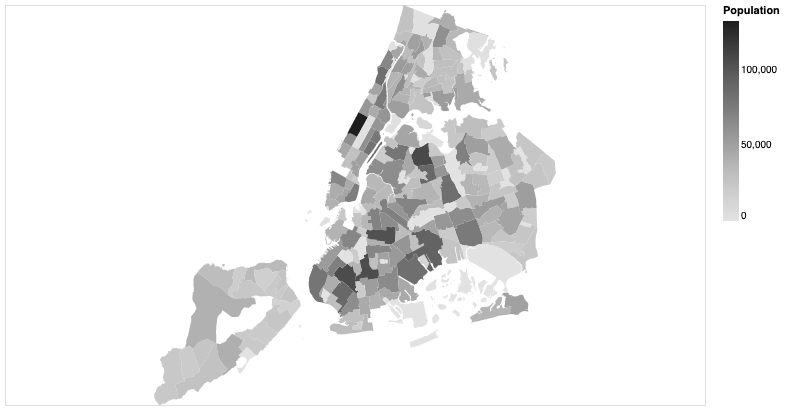

In [55]:
map0

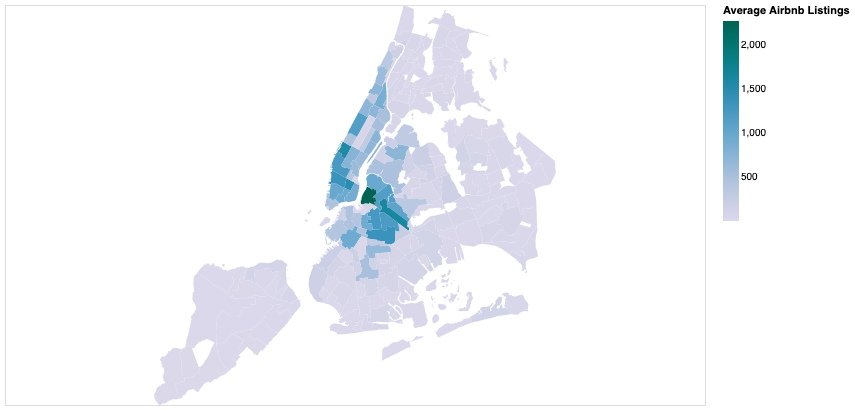

In [56]:
map1 

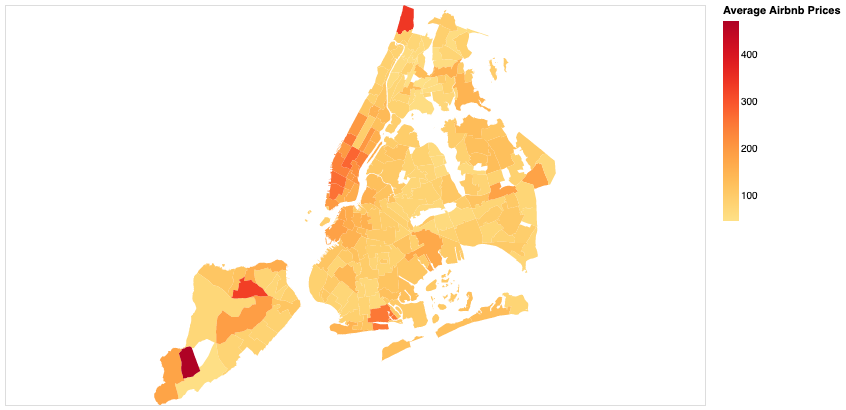

In [57]:
map2

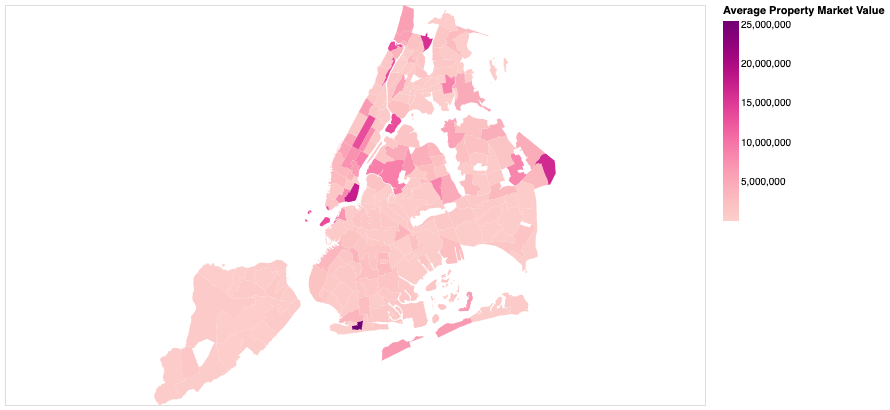

In [58]:
map3

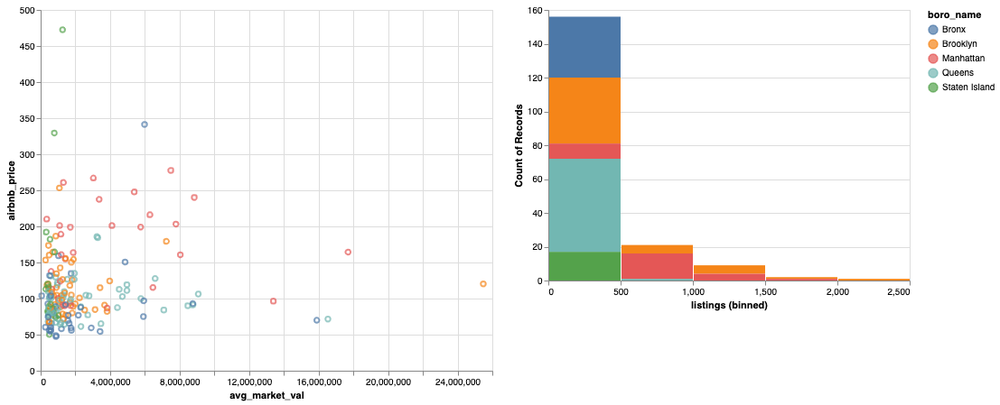

In [59]:
#INTERACTIVE CHARTS
source = finalNeighborhood

brush = alt.selection(type='interval', resolve='global')

scatter1 = alt.Chart(source).mark_point().encode(
    y='airbnb_price',
    x='avg_market_val',
    color=alt.condition(brush, 'boro_name', alt.ColorValue('gray')),
    ).add_selection(
    brush
    ).properties(
    width=500,
    height=400
)

#scatter1

histogram1 = alt.Chart(source).mark_bar().encode(
    x=alt.X("listings:Q", bin=True), y="count()", color="boro_name:N")

chart = alt.hconcat(scatter1, histogram1)
chart

The other interactive plots can be found in the dashboard

Results - Analysis of Structured Data 
Most of the listings are located in Midtown Manhattan and in the area between Queens and Brooklyn near the East River, with the highest concentration in the Brooklyn neighborhood of 'North Side-South Side'. However, the spatial distribution of Airbnb prices does not seem to have much in common with the spatial distribution of Airbnb listings. Furthermore, the property market values only have some spatial similarity with Airbnb listing prices. Not surprisingly, Airbnb listings in the outer boroughs are not very popular with tourists. The data from NYC Open Data that was used to map white and non-white population across the city of New York seemed a bit unreliable. Staten Island which is predominantly white showed a small count of white population thus raising some concerns about the reliability of the demographics data obtained from NYC Open Data. The percentage of low-income housing (as a proportion of total housing units) was mainly situated in the outer boroughs, particularly in Brooklyn, and was not close to any of the Airbnb listing areas.

PART 5: TWITTER DATA ANALYSIS (UNSTRUCTURED DATA)

Twitter data of 2 types were analysed: 

1. Airbnb tweets pertaining to NYC
2. Tweets about Airbnb in general   

This was done since twitter data can be scraped for only 7 days at a time and the number of tweets relating to Airbnb in NYC were very few (only 13 in total). Please note that this analysis was done during the second week of May 2019 on May 12, 2019. Since the number of tweets for Airbnb in NYC was limited, tweets for Airbnb in general i.e., not specific to NYC only, were scrapped. A comparative analysis for both types of twitter data was conducted to find out how people felt about Airbnb in NYC and in other places. Furthermore, since most of the tweets were made by Airbnb customers (and given the limited number of tweets for Airbnb in NYC) it was not possible to find out how New Yorkers felt about Airbnb. However, this analysis helps us get an idea of how Airbnb customers feel about the company and its services. 

In [60]:
#define twitter API keys
consumer_key = "bm05tVNEg3Con4wMBf9DIk8sk"
consumer_secret = "KAcsj6FA0tIbTXwvWkJRoCLoOAC0ljQc6h89MmnVuzfxzfkv0s"
access_token = "1126678439812063232-Y4j7PXdvJcCTqaxqH55k621KtKOM5t"
access_token_secret = "EAoIXHHbD0x17zwhttosMbaGbF9DWgsE0vorTxMPbgNER"

In [61]:
#set up authentication
auth = tw.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_token_secret)
#intialize a tweepy.API object
api = tw.API(auth, wait_on_rate_limit=True)

In [62]:
#set search criteria - 1) Airbnb NYC only 2) Airbnb general
searchWords_airbnbNYC = "#airbnb #nyc OR #newyorkcity OR #manhattan OR #brooklyn OR #queens OR #harlem OR #statenisland"
searchWords_airbnb = "#airbnb"
newSearch_airbnbNYC = searchWords_airbnbNYC + " -filter:retweets"
newSearch_airbnb = searchWords_airbnb + " -filter:retweets"

In [63]:
#load the most recent tweets for #airbnb #nyc
cursor = tw.Cursor(api.search,
                   q=newSearch_airbnbNYC,
                   lang="en",
                   tweet_mode='extended')
tweets_airbnbNYC = [tweet for tweet in cursor.items()]

In [64]:
#Load the most recent tweets for #airbnb
cursor = tw.Cursor(api.search,
                   q=newSearch_airbnb,
                   lang="en",
                   tweet_mode='extended')
tweets_airbnb = [tweet for tweet in cursor.items()]

In [65]:
len(tweets_airbnbNYC)

16

In [66]:
len(tweets_airbnb)

2352

In [67]:
#get the text of the tweets
tweets_text_airbnbNYC = [tweet.full_text for tweet in tweets_airbnbNYC]
tweets_text_airbnb = [tweet.full_text for tweet in tweets_airbnb]

In [68]:
#define function to remove URL
def remove_url(txt):
    import re
    return " ".join(re.sub("https://t.co/[A-Za-z\\d]+|&amp", "", txt).split())

#remove URLS
tweets_noURLs_airbnbNYC = [remove_url(tweet) for tweet in tweets_text_airbnbNYC]
tweets_noURLs_airbnb = [remove_url(tweet) for tweet in tweets_text_airbnb]

In [69]:
#get words
words_airbnbNYC = [tweet.lower().split() for tweet in tweets_noURLs_airbnbNYC]
words_airbnb = [tweet.lower().split() for tweet in tweets_noURLs_airbnb]

In [70]:
#remove stop words
nltk.download('stopwords');
stop_words = set(nltk.corpus.stopwords.words('english'))
tweets_nsw_airbnbNYC = [[word for word in tweet_words if word not in stop_words]
              for tweet_words in words_airbnbNYC]
tweets_nsw_airbnb = [[word for word in tweet_words if word not in stop_words]
              for tweet_words in words_airbnb]

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/sagaridatta/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [71]:
#terms to remove
remove_terms_airbnbNYC = ['#airbnb','#nyc', '#newyorkcity', '#manhattan', '#brooklyn', '#queens', '#harlem', '#statenisland',
                '.']
remove_terms_airbnb = ['#airbnb', '.', '-', ';', '@airbnb', 'airbnb']

In [72]:
#final 
tweets_final_airbnbNYC = [[w for w in word if w not in remove_terms_airbnbNYC]
                          for word in tweets_nsw_airbnbNYC]
tweets_final_airbnb = [[w for w in word if w not in remove_terms_airbnb]
                          for word in tweets_nsw_airbnb]

In [73]:
#define function to get word frequency counts - top 10
def count_word_frequencies(words_in_tweet, top=10):

    # List of all words across tweets
    all_words = list(itertools.chain(*words_in_tweet))
    
    # Create counter
    counter = collections.Counter(all_words)
    
    return pd.DataFrame(counter.most_common(top),
                        columns=['words', 'count'])


counts_final_airbnbNYC = count_word_frequencies(tweets_final_airbnbNYC)
counts_final_airbnb = count_word_frequencies(tweets_final_airbnb)

In [74]:
#define function to get word frequency counts - top 10
def count_word_frequencies20(words_in_tweet, top=20):

    # List of all words across tweets
    all_words = list(itertools.chain(*words_in_tweet))
    
    # Create counter
    counter = collections.Counter(all_words)
    
    return pd.DataFrame(counter.most_common(top),
                        columns=['words', 'count'])


wordCloud_airbnbNYC = count_word_frequencies20(tweets_final_airbnbNYC)
wordCloud_airbnb = count_word_frequencies20(tweets_final_airbnb)

In [75]:
#SENTIMENT ANALYSIS - AIRBNB NYC
blobs_airbnbNYC = [textblob.TextBlob(remove_url(t.full_text)) for t in tweets_airbnbNYC]

data_airbnbNYC = {}
data_airbnbNYC['date'] = [t.created_at for t in tweets_airbnbNYC]
data_airbnbNYC['polarity'] = [b.sentiment.polarity for b in blobs_airbnbNYC]
data_airbnbNYC['subjectivity'] = [b.sentiment.subjectivity for b in blobs_airbnbNYC]
data_airbnbNYC['text'] = [remove_url(t.full_text) for t in tweets_airbnbNYC]
data_airbnbNYC = pd.DataFrame(data_airbnbNYC)
noBias_airbnbNYC = data_airbnbNYC.loc[data_airbnbNYC['polarity']!=0]

In [76]:
#SENTIMENT ANALYSIS - AIRBNB 
blobs_airbnb = [textblob.TextBlob(remove_url(t.full_text)) for t in tweets_airbnb]

data_airbnb = {}
data_airbnb['date'] = [t.created_at for t in tweets_airbnb]
data_airbnb['polarity'] = [b.sentiment.polarity for b in blobs_airbnb]
data_airbnb['subjectivity'] = [b.sentiment.subjectivity for b in blobs_airbnb]
data_airbnb['text'] = [remove_url(t.full_text) for t in tweets_airbnb]
data_airbnb = pd.DataFrame(data_airbnb)
noBias_airbnb = data_airbnb.loc[data_airbnb['polarity']!=0]

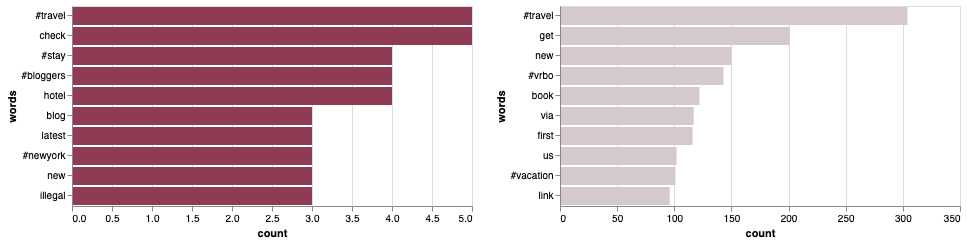

In [77]:
#TWITTER  TOP 10 WORLD COUNT BAR PLOT 
#Airbbnb NYC
twitterPlot1 = alt.Chart(counts_final_airbnbNYC).mark_bar().encode(
    x='count:Q',
    y=alt.Y('words:N',
            sort=alt.EncodingSortField(field="count",order="descending")),
    tooltip=alt.Tooltip('count:Q'),
    color=alt.value('#8e3b53')
)
#Airbbnb
twitterPlot2 = alt.Chart(counts_final_airbnb).mark_bar().encode(
    x='count:Q',
    y=alt.Y('words:N',
            sort=alt.EncodingSortField(field="count",order="descending")),
    tooltip=alt.Tooltip('count:Q'),
    color=alt.value('#d6c9cd')
)

twitterPlot1 | twitterPlot2

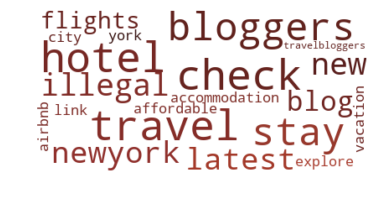

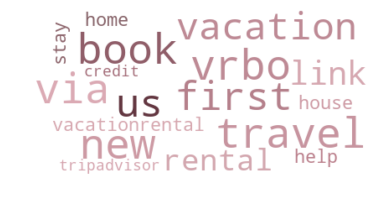

In [78]:
#display top 20 words using word cloud
#credit: https://www.datacamp.com/community/tutorials/wordcloud-python
#images: 123RF.com, justcandy.com

#use mask image to get color palette
mask1 = np.array(Image.open("colorfulImage.png"))
image_colors1 = ImageColorGenerator(mask1)
mask2 = np.array(Image.open("colorfulImage2.png"))
image_colors2 = ImageColorGenerator(mask2)

#generate word for Airbnb NYC 
words_df_airbnbNYC = wordCloud_airbnbNYC['words']
text_airbnbNYC = '.'.join(words_df_airbnbNYC)
wordcloud_airbnbNYC = WordCloud(max_font_size=50,background_color ='white').generate(text_airbnbNYC)
plt.figure()
plt.imshow(wordcloud_airbnbNYC.recolor(color_func=image_colors2), interpolation="bilinear")
plt.axis("off")
plt.show()


#generate word for Airbnb 
words_df_airbnb = wordCloud_airbnb['words']
text_airbnb = '.'.join(words_df_airbnb)
wordcloud_airbnb = WordCloud(max_font_size=50,background_color ='white').generate(text_airbnb)
plt.figure()
plt.imshow(wordcloud_airbnb.recolor(color_func=image_colors1), interpolation="bilinear")
plt.axis("off")
plt.show()


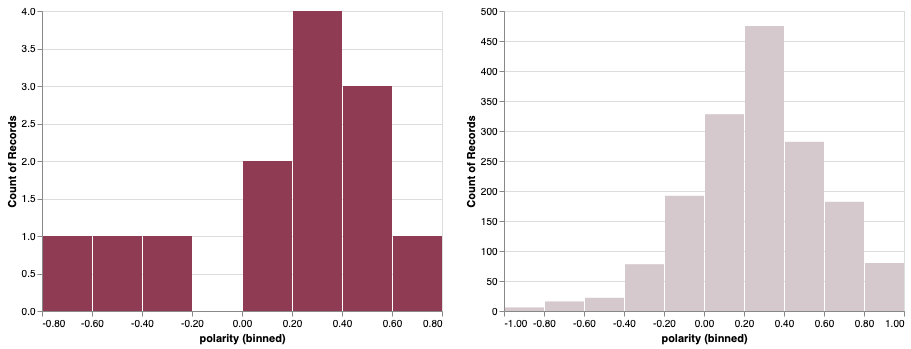

In [79]:
#POLARITY PLOT
#Airbbnb NYC
polarityPlot1 = alt.Chart(noBias_airbnbNYC).mark_bar().encode(
    alt.X('polarity:Q', bin=True),
    y='count()',
    tooltip=alt.Tooltip('count():Q'),
    color=alt.value('#8e3b53')
)
#Airbbnb 
polarityPlot2 = alt.Chart(noBias_airbnb).mark_bar().encode(
    alt.X('polarity:Q', bin=True),
    y='count()',
    tooltip=alt.Tooltip('count():Q'),
    color=alt.value('#d6c9cd')
)

polarityPlot1 | polarityPlot2

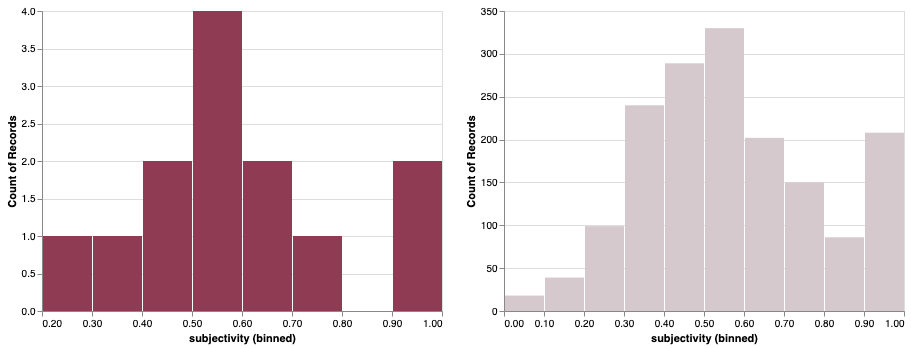

In [80]:
#SUBJECTIVITY PLOT
#Airbbnb NYC
subjectivityPlot1 = alt.Chart(noBias_airbnbNYC).mark_bar().encode(
    alt.X('subjectivity:Q', bin=True),
    y='count()',
    tooltip=alt.Tooltip('count():Q'),
    color=alt.value('#8e3b53')
)
#Airbbnb
subjectivityPlot2 = alt.Chart(noBias_airbnb).mark_bar().encode(
    alt.X('subjectivity:Q', bin=True),
    y='count()',
    tooltip=alt.Tooltip('count():Q'),
    color=alt.value('#d6c9cd')
)

subjectivityPlot1 | subjectivityPlot2

/Users/sagaridatta/anaconda3/envs/musa-620/lib/python3.6/site-packages/matplotlib/figure.py:445: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


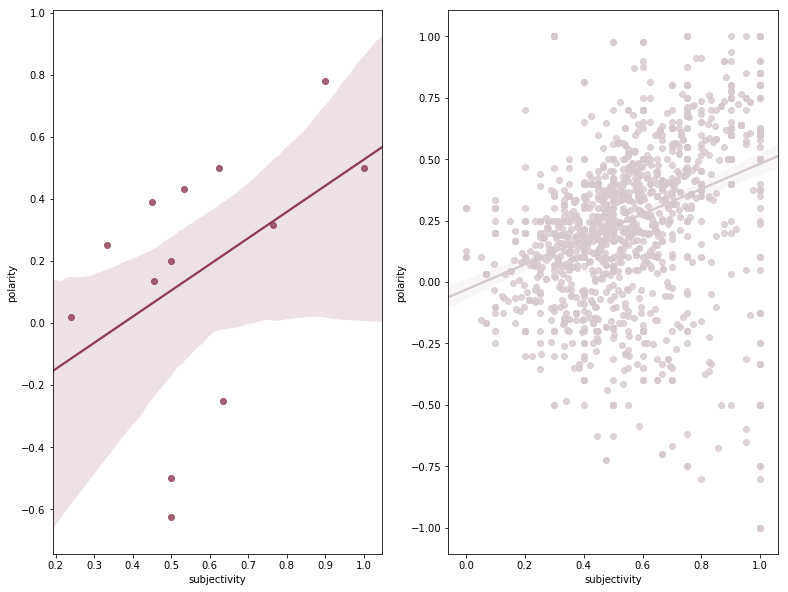

In [81]:
#REGRESSION PLOT 
fig, ax =plt.subplots(1,2, figsize=(13,10))
#Airbbnb NYC
sns.regplot(x=noBias_airbnbNYC['subjectivity'], y=noBias_airbnbNYC['polarity'], color='#8e3b53', ax=ax[0])
#Airbbnb 
sns.regplot(x=noBias_airbnb['subjectivity'], y=noBias_airbnb['polarity'], color='#d6c9cd', ax=ax[1])
fig.show()

From the results it can be seen that the polarization of comments is more for Airbnb overall than it is for Airbnb in NYC. Moreover, the top 10 and 20 words counts for both were either neutral or positive words. However, the results need to be considered with caution since the number of tweets available for analysis for Airbnb NYC is quite limited. Furthermore, twitter data only shows the feelings of twitter users and therefore is not a representative sample.

APPENDIX

In [82]:
# #PART 1.3: DOWNLOAD CENSUS DATA
# #set up API key
# api_key = " e4234d4bc6b50eca2a38b8ed1cd70a93261fb1de"
# c = Census(key=api_key)
# #FIPS code
# ny_state_code = 36
# nyc_place_code = 51000
# population and geometry
# variables = ('NAME', 'B02001_001E')
# pop_tracts = c.acs5.state_place_tract(variables, ny_state_code, 
#                                       nyc_place_code, 
#                                       return_geometry=True)
# #Race variables
# variables = ['B02001_001E', 'B03002_003E', 'B03002_012E', 'B03002_004E',  
#              'B03002_006E', 'B03002_005E', 'B03002_007E', 
#              'B03002_008E', 'B03002_009E']
# demo_tracts = c.acs5.state_place_blockgroup(variables, 
#                                          ny_state_code, 
#                                          nyc_place_code)
# #gross rent and median household income variables
# variables = ['B25074_049E', 'B25119_002E']
# property_tract = c.acs5.state_place_blockgroup(variables, 
#                                          ny_state_code, 
#                                          nyc_place_code)